<a href="https://colab.research.google.com/github/FilipJosifljevic/LeafClassification/blob/main/Leaf_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Uvod

Klasifikacija je proces nadgledanog mašinskog učenja koji podrazumeva kategorizovanje seta ulaznih podataka u klase na osnovu jedne ili više promenljivih.Takođe, klasifikacija može biti primenjena na strukturiranim ili nestrukturiranim podacima kako bi se precizno predvidelo da li će ili ne upasti u određenu kategoriju.Neke od primena klasifikacije su : klasifikacija fotografija, detekcija prevara, detekcija spama, klasifikacija dokumenata, klasifikacija *malware*-a itd  [1].Zadati problem je problem klasifikacije fotografija na osnovu zadatog dataseta sa fotografijama lišća različitih biljaka.

Učitavanje *dataset*-a sa dobijenog linka pomoću *wget* funkcije ignorišući proveru autentifikacije, i smeštanje u leaf.zip fajl

In [ ]:
!wget --no-check-certificate 'https://drive.usercontent.google.com/download?id=1r4yy2ZIUGoyESydQzY39L-0s8ld7fuXr&export=download&authuser=0&confirm=t&uuid=5f7362ee-9d8e-425f-9d38-f367a0e1f2b3&at=APZUnTXK6pXf7pBY2D5tbgQ3lnzc%3A1705520051008' -O leaf.zip

--2024-02-05 21:31:03--  https://drive.usercontent.google.com/download?id=1r4yy2ZIUGoyESydQzY39L-0s8ld7fuXr&export=download&authuser=0&confirm=t&uuid=5f7362ee-9d8e-425f-9d38-f367a0e1f2b3&at=APZUnTXK6pXf7pBY2D5tbgQ3lnzc%3A1705520051008
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 172.217.194.132, 2404:6800:4003:c04::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|172.217.194.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35953027 (34M) [application/octet-stream]
Saving to: ‘leaf.zip’

leaf.zip            100%[===================>]  34.29M  52.4MB/s    in 0.7s    

2024-02-05 21:31:04 (52.4 MB/s) - ‘leaf.zip’ saved [35953027/35953027]



Ekstrakcijom dobijenog foldera uviđamo postojanje 3 dodatna zip-ovana fajla unutar njega : train.csv.zip, test.csv.zip, sample_submission.csv.zip i foldera sa fotografijama images.zip

In [ ]:
!unzip leaf.zip

Archive:  leaf.zip
  inflating: images.zip              
  inflating: sample_submission.csv.zip  
  inflating: test.csv.zip            
  inflating: train.csv.zip           


Vršimo ekstrakciju i tih fajlova

In [ ]:
!unzip images.zip
!unzip test.csv.zip
!unzip train.csv.zip
!unzip sample_submission.csv.zip

Archive:  images.zip
   creating: images/
  inflating: images/1.jpg            
  inflating: images/10.jpg           
  inflating: images/100.jpg          
  inflating: images/1000.jpg         
  inflating: images/1001.jpg         
  inflating: images/1002.jpg         
  inflating: images/1003.jpg         
  inflating: images/1004.jpg         
  inflating: images/1005.jpg         
  inflating: images/1006.jpg         
  inflating: images/1007.jpg         
  inflating: images/1008.jpg         
  inflating: images/1009.jpg         
  inflating: images/101.jpg          
  inflating: images/1010.jpg         
  inflating: images/1011.jpg         
  inflating: images/1012.jpg         
  inflating: images/1013.jpg         
  inflating: images/1014.jpg         
  inflating: images/1015.jpg         
  inflating: images/1016.jpg         
  inflating: images/1017.jpg         
  inflating: images/1018.jpg         
  inflating: images/1019.jpg         
  inflating: images/102.jpg          
  inflat

Nakon što smo raspakovali sve fajlove, pomoću *pandas* biblioteke učitavamo potrebne .csv fajlove i smeštamo ih u promenljive.

In [ ]:
import pandas as pd

train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
sample_submission = pd.read_csv('sample_submission.csv')

Vršimo pregled strukture učitanih fajlova i ispisujemo broj kolona i redova uz pomoć funkcije *shape*

# Istraživanje *dataset*-a

In [ ]:
print(train)
print(test)
print(sample_submission)
print('Number of rows and columns in the train dataframe : ' + str(train.shape))
print('Number of rows and columns in the test dataframe : ' + str(test.shape))
print('Number of rows and columns in sample_submission dataframe : ' + str(sample_submission.shape))

       id                species   margin1   margin2   margin3   margin4  \
0       1            Acer_Opalus  0.007812  0.023438  0.023438  0.003906   
1       2  Pterocarya_Stenoptera  0.005859  0.000000  0.031250  0.015625   
2       3   Quercus_Hartwissiana  0.005859  0.009766  0.019531  0.007812   
3       5        Tilia_Tomentosa  0.000000  0.003906  0.023438  0.005859   
4       6     Quercus_Variabilis  0.005859  0.003906  0.048828  0.009766   
..    ...                    ...       ...       ...       ...       ...   
985  1575   Magnolia_Salicifolia  0.060547  0.119140  0.007812  0.003906   
986  1578            Acer_Pictum  0.001953  0.003906  0.021484  0.107420   
987  1581     Alnus_Maximowiczii  0.001953  0.003906  0.000000  0.021484   
988  1582          Quercus_Rubra  0.000000  0.000000  0.046875  0.056641   
989  1584         Quercus_Afares  0.023438  0.019531  0.031250  0.015625   

      margin5   margin6   margin7  margin8  ...  texture55  texture56  \
0    0.011719 

Takođe vršimo štampanje svih fotografija iz foldera *images* kako bi se upoznali sa strukturom problema

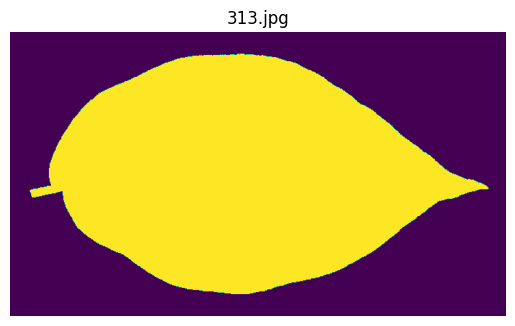

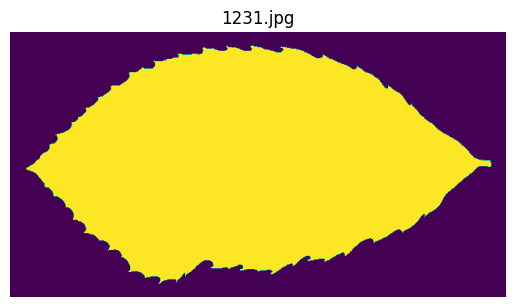

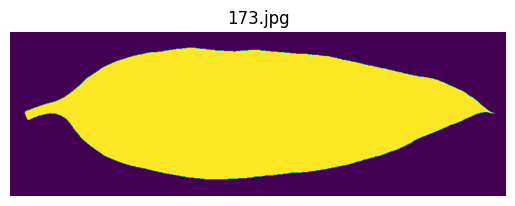

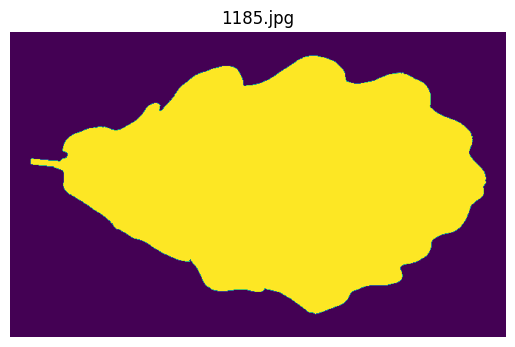

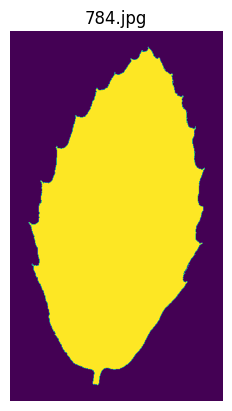

...

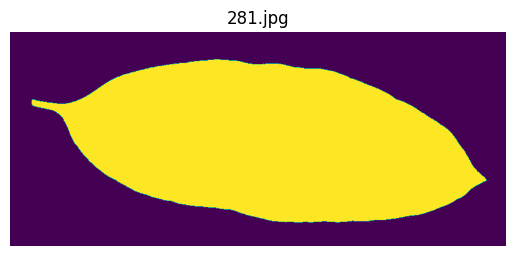

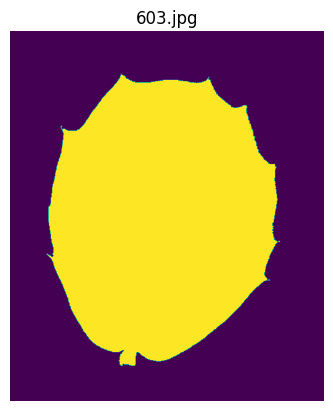

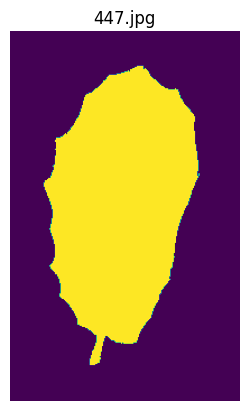

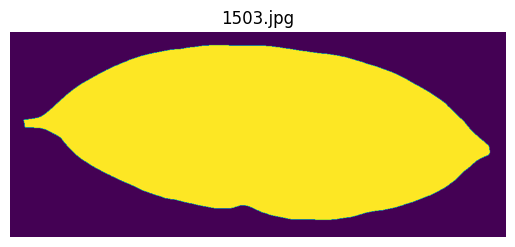

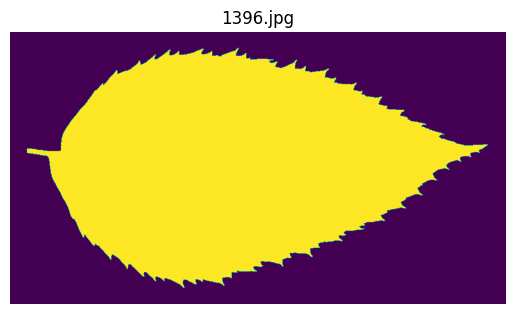

In [ ]:
import os
os.chdir('/content/images')

image_files = [f for f in os.listdir() if f.endswith(('jpg', 'jpeg', 'png', 'gif'))]

for image_file in image_files:
    img_path = os.path.join('/content/images', image_file)
    img = plt.imread(img_path)

    plt.imshow(img)
    plt.title(image_file)
    plt.axis('off')
    plt.show()

Kako je zadati problem problem klasifikacije, ispisujemo sve jedinstvene nazive klasa biljaka kojima pripada zadato lišće. To radimo tako što vršimo ispis jedinstvenih naziva u koloni *species* koja nam predstavlja ciljani *feature*

In [ ]:
print('Total number of unique classes : ' + str(train['species'].nunique()))

Total number of unique classes : 99


Balansiranost *dataset*-a ispitujemo tako što vršimo ispis broja pojavljivanja svake klase u train *dataset*-u.Kako ukupno imamo 99 jednakih klasa, od kojih se svaka pojavljuje tačno 10 puta(od ukupno 990 redova), možemo zaključiti da je *dataset* savršeno balansiran.Takođe ispisujemo unikatne nazive svih klasa koje se pojavljuju

In [ ]:
by_class = pd.Series(train['species']).value_counts()
print(by_class)
print('Rows :' + str(len(train))) ##dataset je balansiran jer imamo po 10 primeraka svake klase a 990 primeraka ukupno(99 klasa)
print(train['species'].unique())

Acer_Opalus                    10
Crataegus_Monogyna             10
Acer_Mono                      10
Magnolia_Heptapeta             10
Acer_Capillipes                10
                               ..
Alnus_Rubra                    10
Rhododendron_x_Russellianum    10
Cytisus_Battandieri            10
Liriodendron_Tulipifera        10
Sorbus_Aria                    10
Name: species, Length: 99, dtype: int64
Rows :990
['Acer_Opalus' 'Pterocarya_Stenoptera' 'Quercus_Hartwissiana'
 'Tilia_Tomentosa' 'Quercus_Variabilis' 'Magnolia_Salicifolia'
 'Quercus_Canariensis' 'Quercus_Rubra' 'Quercus_Brantii' 'Salix_Fragilis'
 'Zelkova_Serrata' 'Betula_Austrosinensis' 'Quercus_Pontica'
 'Quercus_Afares' 'Quercus_Coccifera' 'Fagus_Sylvatica' 'Phildelphus'
 'Acer_Palmatum' 'Quercus_Pubescens' 'Populus_Adenopoda' 'Quercus_Trojana'
 'Alnus_Sieboldiana' 'Quercus_Ilex' 'Arundinaria_Simonii'
 'Acer_Platanoids' 'Quercus_Phillyraeoides' 'Cornus_Chinensis'
 'Liriodendron_Tulipifera' 'Cytisus_Battandieri'
 

# Kreiranje *CNN* modela

Neuronska mreža je sistem sastavljen od više jednostavnih procesora (jedinica, neurona), svaki od njih ima lokalnu memoriju u kojoj pamti podatke koje obrađuje. Te jedinice su povezane komunikacionim kanalima (vezama). Podaci koji se ovim kanalima razmenjuju su obično numerički. Jedinice obrađuju samo svoje lokalne podatke i ulaze koje primaju preko konekcije. Ograničenja lokalnih operatora se mogu otkloniti tokom treninga[2].

Konvolucijske neuronske mreže(eng. *Convolutional Neural Networks*) su vrsta neuronskih mreža koje se vezuju za pojam dubokog učenja i predstavljaju biološki inspirisanu verziju višeslojnog perceptrona.U okviru ove mreže se koriste konvolucioni filteri koji služe za izoštravanje i zamućivanje slika, kao i za detekciju ivica[3].

U sledećem primeru ćemo kreirati jednostavnu jednodimenzionalnu konvolucijsku neuronsku mrežu kako bi rešili zadati problem klasifikacije lišća.

U prvom koraku importujemo sve potrebne biblioteke koje ćemo koristiti za pripremu podataka i definisanje modela.Definišemo funkciju ***encode*** koju koristimo za pretvaranje imena kategorija(*species*) u numeričke vrednosti.Promenljiva *labels* nam sada sadrži sve numeričke vrednosti dok nam promenljiva *classes* sadrži tekstualne vrednosti imena klasa koje možemo kasnije iskoristiti za dekodiranje unazad. Na kraju funcije vraćamo sve potrebne promenljive.

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedShuffleSplit
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, Convolution1D, Dropout
from keras.optimizers import SGD
from keras import utils
from keras.callbacks import ModelCheckpoint

def encode(train, test):
    label_encoder = LabelEncoder().fit(train.species)
    labels = label_encoder.transform(train.species)
    classes = list(label_encoder.classes_)

    train = train.drop(['species', 'id'], axis=1)
    test_ids=test.id
    test = test.drop('id', axis=1)

    return train, labels, test, classes,test_ids

train, labels, test, classes,test_ids = encode(train, test)

Sada je potrebno standardizovati dobijene numeričke vrednosti pomoću *Standard Scaler* biblioteke.Nakon toga ćemo odraditi split na trening i validacione podatke pomoću *StratifiedShuffleSplit*-a, gde ćemo sačuvati distribuciju podataka po klasama.Dodeljujemo vrednosti promenljivima koje sadrže broj *feature*-a i ukupan broj klasa.

In [ ]:
scaler = StandardScaler().fit(train.values)
scaled_train = scaler.transform(train.values)

sss = StratifiedShuffleSplit(test_size=0.2, random_state=23)
for train_index, valid_index in sss.split(scaled_train, labels):
    X_train, X_valid = scaled_train[train_index], scaled_train[valid_index]
    y_train, y_valid = labels[train_index], labels[valid_index]

num_features = 64
num_class = len(classes)

*Reshaping* trening i validacionih promenljivih kako bi se napravio format koji odgovara ulaznom *CNN* formatu.

In [ ]:
X_train_r = np.zeros((len(X_train), num_features, 3))
X_train_r[:, :, 0] = X_train[:, :num_features]
X_train_r[:, :, 1] = X_train[:, num_features:128]
X_train_r[:, :, 2] = X_train[:, 128:]

X_valid_r = np.zeros((len(X_valid), num_features, 3))
X_valid_r[:, :, 0] = X_valid[:, :num_features]
X_valid_r[:, :, 1] = X_valid[:, num_features:128]
X_valid_r[:, :, 2] = X_valid[:, 128:]

Sledi importovanje dodatnih biblioteka i kreiranje modela sa potrebnim parametrima.Kreira se 1D *CNN* model(512 filtera, veličina *kernel*-a 1 i broj ulaznih *feature*-a 1) gde se *output* predstavlja kao jednodimenzionalni niz pomoću metode *Flatten*.Dropout metoda se koristi za kontrolu *overfitting*-a.Vrši se kompajliranje modela gde se koristi *Stochastic Gradient Descent* (*SGD*) kao optimizator.Model se trenira i ispisuju se željeni parametri koji su u ovom slučaju preciznost i gubici validacije i treninga.Na kraju se vrši *reshaping* test podataka i radi se predviđanje.

In [ ]:
from keras import utils
from keras.callbacks import ModelCheckpoint

model = Sequential()
model.add(Convolution1D(512, 1, input_shape=(num_features, 3)))
model.add(Activation('relu'))
model.add(Flatten())
model.add(Dropout(0.4))
model.add(Dense(2048, activation='relu'))
model.add(Dense(1024, activation='relu'))
model.add(Dense(num_class))
model.add(Activation('softmax'))

y_train = utils.to_categorical(y_train, num_class)
y_valid = utils.to_categorical(y_valid, num_class)

sgd = SGD(learning_rate=0.01, nesterov=True, momentum=0.9)
model.compile(loss='categorical_crossentropy',optimizer=sgd, metrics = ["accuracy"])

best_model_file = "leafCNN.h5"
best_model = ModelCheckpoint(best_model_file, monitor='val_loss', verbose=1, save_best_only=True)

nb_epoch = 15
history = model.fit(X_train_r, y_train, epochs=nb_epoch,
          validation_data=(X_valid_r, y_valid),
          batch_size=16, callbacks=[best_model])

print('val_acc: ',max(history.history['val_accuracy']))
print('val_loss: ',min(history.history['val_loss']))
print('train_acc: ',max(history.history['accuracy']))
print('train_loss: ',min(history.history['loss']))

print()
print("train/val loss ratio: ", min(history.history['loss'])/min(history.history['val_loss']))


scaler = StandardScaler().fit(test.values)
scaled_test = scaler.transform(test.values)

test_dataset = np.zeros((len(scaled_test), num_features, 3))
test_dataset[:, :, 0] = scaled_test[:, :num_features]
test_dataset[:, :, 1] = scaled_test[:, num_features:128]
test_dataset[:, :, 2] = scaled_test[:, 128:]

preds_test = model.predict(test_dataset)
preds_test

Epoch 1/15
50/50 [==============================] - ETA: 0s - loss: 3.9456 - accuracy: 0.1679
Epoch 1: val_loss improved from inf to 1.97870, saving model to leafCNN.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


50/50 [==============================] - 7s 66ms/step - loss: 3.9456 - accuracy: 0.1679 - val_loss: 1.9787 - val_accuracy: 0.6364
Epoch 2/15
48/50 [===========================>..] - ETA: 0s - loss: 0.9741 - accuracy: 0.7773
Epoch 2: val_loss improved from 1.97870 to 0.46334, saving model to leafCNN.h5
50/50 [==============================] - 4s 86ms/step - loss: 0.9534 - accuracy: 0.7816 - val_loss: 0.4633 - val_accuracy: 0.9040
Epoch 3/15
50/50 [==============================] - ETA: 0s - loss: 0.1684 - accuracy: 0.9697
Epoch 3: val_loss improved from 0.46334 to 0.14866, saving model to leafCNN.h5
50/50 [==============================] - 3s 55ms/step - loss: 0.1684 - accuracy: 0.9697 - val_loss: 0.1487 - val_accuracy: 0.9596
Epoch 4/15
48/50 [===========================>..] - ETA: 0s - loss: 0.0592 - accuracy: 0.9857
Epoch 4: val_loss improved from 0.14866 to 0.10158, saving model to leafCNN.h5
50/50 [==============================] - 3s 56ms/step - loss: 0.0580 - accuracy: 0.9861 - v

array([[2.58167802e-07, 6.27165605e-07, 3.94174435e-08, ...,
        5.66914409e-08, 7.83856376e-06, 2.52428663e-07],
       [2.14613127e-08, 1.16016665e-07, 3.58699231e-06, ...,
        2.42592669e-05, 3.68842956e-09, 1.71399563e-07],
       [3.55428961e-06, 9.94140923e-01, 9.80295454e-07, ...,
        1.09149028e-07, 3.54504408e-08, 1.17680356e-04],
       ...,
       [3.40009428e-05, 5.12564270e-07, 8.84680702e-08, ...,
        1.59906961e-07, 6.71456277e-08, 2.95247696e-06],
       [1.61775676e-10, 2.24918062e-09, 5.96603400e-07, ...,
        4.75284381e-08, 6.10485898e-11, 1.04543763e-09],
       [3.84895360e-09, 5.59681226e-08, 4.31929806e-07, ...,
        8.77020909e-08, 6.68664546e-09, 2.24275084e-07]], dtype=float32)

Vršimo *plot*-ovanje izmerenih vrednosti preciznosti i gubitaka treninga i validacije.

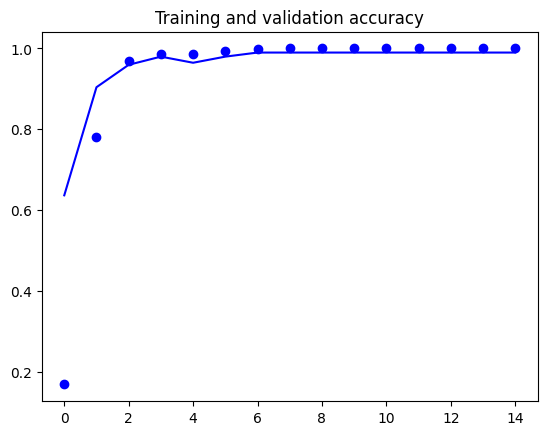

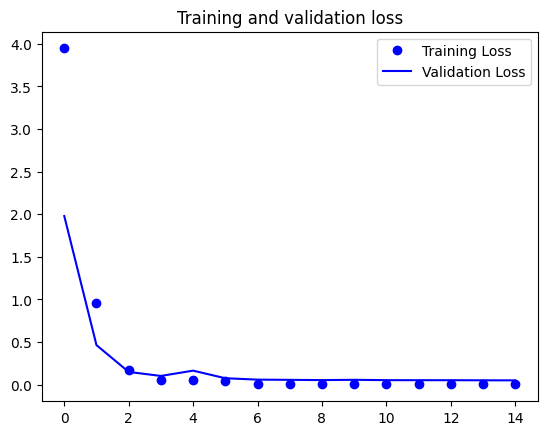

In [ ]:
epochs = range(len(history.history['accuracy']))
plt.plot(epochs, history.history['accuracy'], 'bo', label='Training accuracy')
plt.plot(epochs, history.history['val_accuracy'], 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')

plt.figure()

plt.plot(epochs, history.history['loss'], 'bo', label='Training Loss')
plt.plot(epochs, history.history['val_loss'], 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# Kreiranje *VGG19* modela

Jedan od korišćenih modela jeste i *VGG19*.On predstavlja konvolucijsku neuralnu mrežu sa 19 slojeva koja je pretrenirana i može klasifikovati objekte u više od 1000 različitih kategorija.Ulazne fotografije moraju biti veličine 224x224 [4].

Za početak importujemo potrebne biblioteke i ponovo učitavamo potrebne fajlove kako bi imali čisti početak.Takođe vršimo konkatenaciju putanje do foldera sa fotografijama i njihovog *id*-ja kako bi dobili potpuni *ImagePath* koji će služiti modelu za lociranje fotografija.

In [ ]:
import numpy as np
import pandas as pd
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
import keras
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten


train = pd.read_csv('train.csv')
#print(train)
test = pd.read_csv('test.csv')
images_path = '/content/images/'

train['ImagePath'] = images_path + train['id'].astype(str) + '.jpg'
train['ImagePath']

test['ImagePath'] = images_path + test['id'].astype(str) + '.jpg'
test['ImagePath']

0         /content/images/4.jpg
1         /content/images/7.jpg
2         /content/images/9.jpg
3        /content/images/12.jpg
4        /content/images/13.jpg
                 ...           
589    /content/images/1576.jpg
590    /content/images/1577.jpg
591    /content/images/1579.jpg
592    /content/images/1580.jpg
593    /content/images/1583.jpg
Name: ImagePath, Length: 594, dtype: object

Koristimo *ImageDataGenerator* kako bi fotografije prilagodili ulaznom formatu koji model prihvata.Takođe generišemo fotografije za trening, validaciju i test uz pomoć generatora.

In [ ]:
TRAIN_GEN = ImageDataGenerator(
    rescale=1./255, #normalisation of images
    #Augmentation
    rotation_range=40,
    shear_range=0.2,
    zoom_range =0.2,
    fill_mode='nearest',
    validation_split=0.2,
    horizontal_flip= True)

traindata = TRAIN_GEN.flow_from_dataframe(train,
                                      x_col='ImagePath',
                                      y_col='species',
                                      target_size=(224,224),
                                      class_mode='categorical',
                                      subset='training',
                                      seed=123,
                                      batch_size=32)


validationdata= TRAIN_GEN.flow_from_dataframe(train,
                                    x_col='ImagePath',
                                    y_col='species',
                                    target_size=(224,224),
                                    class_mode='categorical',
                                    subset='validation',
                                    seed=123,
                                    batch_size=32)

Test_gen=ImageDataGenerator(rescale=1./255)
testdata= Test_gen.flow_from_dataframe(test,
                                    x_col='ImagePath',
                                    y_col=None,
                                    target_size=(224,224),
                                    class_mode=None,
                                    seed=123,
                                    shuffle=False,
                                    batch_size=32)

Found 792 validated image filenames belonging to 99 classes.
Found 198 validated image filenames belonging to 99 classes.
Found 594 validated image filenames.


Importujemo biblioteku modela ***VGG19*** i kompajliramo model koristeći "*Adam*" optimizator.Model fit-ujemo trening i validacionim podacima i počinjemo treniranje u 10 epoha sa po 15 koraka.

In [ ]:
from tensorflow.keras.applications.vgg19 import VGG19

model = VGG19(include_top=False, input_shape=(224, 224, 3))

for layer in model.layers:
    layer.trainable=False
pretrained_part = Flatten()(model.layers[-1].output)

class_ = Dense(256, activation='relu')(pretrained_part)
output = Dense(99, activation='sigmoid')(class_)
model = Model(inputs = model.inputs, outputs = output)

model.compile(optimizer='Adam',loss='binary_crossentropy',metrics=[('Accuracy')])

model.summary()



model.fit(traindata,
           validation_data=validationdata,
           epochs=10,
           steps_per_epoch=15,
           verbose=1)

80134624/80134624 [==============================] - 4s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

Nakon treniranja modela vršimo predikcije tako što ubacujemo generisane testne podatke, i štampamo dobijene rezultate predviđanja.

In [ ]:
predictions=model.predict(testdata)
predictions

pred_labels=[ np.argmax(i) for i in predictions]
print(pred_labels)

19/19 [==============================] - 7s 368ms/step
[3, 53, 1, 41, 14, 3, 3, 28, 74, 8, 24, 74, 75, 10, 52, 46, 45, 34, 13, 71, 52, 65, 24, 3, 1, 70, 28, 70, 35, 70, 53, 74, 47, 53, 4, 36, 14, 55, 36, 41, 8, 32, 8, 9, 71, 70, 44, 24, 94, 18, 17, 35, 55, 94, 14, 55, 62, 74, 79, 98, 62, 56, 21, 59, 65, 11, 41, 35, 13, 4, 53, 57, 30, 7, 52, 98, 10, 53, 30, 10, 96, 43, 85, 24, 1, 44, 30, 83, 24, 44, 41, 90, 39, 21, 24, 56, 41, 41, 7, 89, 98, 74, 3, 12, 3, 18, 53, 96, 64, 18, 41, 41, 24, 24, 8, 96, 3, 56, 6, 30, 34, 18, 52, 17, 75, 27, 45, 3, 39, 24, 30, 2, 41, 52, 24, 30, 24, 24, 68, 81, 27, 3, 55, 62, 3, 52, 41, 3, 42, 96, 41, 41, 63, 35, 53, 1, 26, 24, 24, 75, 41, 52, 46, 79, 24, 79, 69, 87, 65, 30, 75, 21, 30, 21, 11, 10, 70, 41, 27, 24, 15, 45, 89, 65, 52, 35, 30, 41, 24, 49, 89, 62, 36, 11, 96, 41, 18, 12, 24, 64, 63, 6, 78, 45, 28, 9, 78, 90, 44, 89, 92, 41, 2, 63, 41, 96, 70, 32, 30, 78, 12, 55, 44, 24, 35, 3, 49, 81, 41, 30, 92, 28, 90, 79, 39, 24, 49, 41, 76, 27, 70, 71, 44, 70

# Kreiranje *InceptionV3* modela

Inception-v3 predstavlja konvolucijsku neuralnu mrežu koja je duboka 48 slojeva.Kao i VGG19 ovaj model je pretreniran na velikom broju podataka i može se koristiti za klasifikaciju preko 1000 vrsta objekata.Veličine ulaznih podataka za ovaj model su 299x299 [5].

Kao i kod prethodnog modela, koristimo ImageDataGenerator kako bi stvorili slike odgovarajućeg formata.Nakon toga treniramo model u ukupno 10 epoha sa po 30 koraka u svakoj i ispisujemo rezultate.Takođe definišemo funkciju ***myCallback*** koja će zaustaviti treniranje modela kada dostigne preciznost od 99% kako ne bi došlo do *overfit*-ovanja.

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras import layers
from keras import metrics


inception_model = InceptionV3(input_shape = (299, 299, 3),
                              include_top = False,
                              weights = 'imagenet')

for layer in inception_model.layers:
  layer.trainable = False

x = layers.Flatten()(inception_model.output)
x = layers.Dense(1024, activation = 'relu')(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(1, activation = 'sigmoid')(x)

model = Model(inception_model.input, x)
model.compile(optimizer = RMSprop(learning_rate=0.0001),
              loss = 'binary_crossentropy',
              metrics = ["accuracy"])

class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('accuracy')>0.999):
      print("\nReached 99.9% accuracy so cancelling training!")
      self.model.stop_training = True

train_datagen = ImageDataGenerator(rescale = 1./255.,
                                   rotation_range = 40,
                                   width_shift_range = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator( rescale = 1.0/255. )
train_generator = train_datagen.flow_from_dataframe(train,
                                                    x_col='ImagePath',
                                                    y_col='species',
                                                    target_size=(299,299),
                                                    class_mode='categorical',
                                                    subset='training',
                                                    seed=123,
                                                    batch_size=20)

validation_generator =  test_datagen.flow_from_dataframe(train,
                                                    x_col='ImagePath',
                                                    y_col='species',
                                                    target_size=(299,299),
                                                    class_mode='categorical',
                                                    subset='validation',
                                                    seed=123,
                                                    batch_size=20)

callbacks = myCallback()
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = 30,
            epochs = 10,
            validation_steps = 5,
            verbose = 2,
            callbacks=[callbacks])

87910968/87910968 [==============================] - 5s 0us/step
Found 990 validated image filenames belonging to 99 classes.
Found 0 validated image filenames belonging to 99 classes.
Epoch 1/10
30/30 - 21s - loss: 0.7689 - accuracy: 0.9605 - 21s/epoch - 692ms/step
Epoch 2/10
30/30 - 15s - loss: 0.1734 - accuracy: 0.9799 - 15s/epoch - 495ms/step
Epoch 3/10
30/30 - 13s - loss: 0.1864 - accuracy: 0.9766 - 13s/epoch - 433ms/step
Epoch 4/10
30/30 - 13s - loss: 0.1098 - accuracy: 0.9866 - 13s/epoch - 437ms/step
Epoch 5/10
30/30 - 13s - loss: 0.0993 - accuracy: 0.9882 - 13s/epoch - 432ms/step
Epoch 6/10
30/30 - 13s - loss: 0.0758 - accuracy: 0.9899 - 13s/epoch - 432ms/step
Epoch 7/10
30/30 - 14s - loss: 0.0668 - accuracy: 0.9899 - 14s/epoch - 462ms/step
Epoch 8/10
30/30 - 13s - loss: 0.0598 - accuracy: 0.9899 - 13s/epoch - 437ms/step
Epoch 9/10
30/30 - 13s - loss: 0.0581 - accuracy: 0.9899 - 13s/epoch - 435ms/step
Epoch 10/10
30/30 - 13s - loss: 0.0578 - accuracy: 0.9899 - 13s/epoch - 431ms

# Klasični klasifikatori

Pored korišćenja konvolucijskih neuronskih mreža, istrenirano je i par klasičnih modela u svrhu poređenja rezultata.Izabrani klasifikatori su *KNearestNeighbors*, *LogisticRegresision*,*SGD* i *RandomForest*.

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import linear_model
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier

train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

Y_train=train.iloc[:,1]
X_train=train.iloc[:,2:]

X_test=test.iloc[:,1:]

Podaci su pripremljeni na odgovarajući način i modeli su *fit*-ovani i pušteni na treniranje.

In [ ]:
logreg = LogisticRegression()
logreg.fit(X_train, Y_train)

pred=logreg.predict(X_train)

knn= KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train, Y_train)

Y_predict=knn.predict(X_train)

clf = KNeighborsClassifier(3)
clf.fit(X_train, Y_train)
test_predictions = clf.predict_proba(X_test)

sgd = SGDClassifier(loss="hinge", penalty="l2", max_iter=10)
sgd.fit(X_train, Y_train)

sgd_pred = sgd.predict(X_train)

rfc = RandomForestClassifier(n_estimators=10)
rfc.fit(X_train, Y_train)
rfc_pred = rfc.predict(X_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


Nakon što je svaki model istreniran, izračunata je preciznost i modeli su upoređeni.

In [ ]:
from sklearn.metrics import accuracy_score

accuracyknn=accuracy_score (Y_train, Y_predict)
accuracylr=accuracy_score (Y_train, pred)
acccuracysgd=accuracy_score (Y_train, sgd_pred)
acccuracyrfc=accuracy_score (Y_train, rfc_pred)
print("KNN Accuracy is {0:.2f}%".format(accuracyknn*100))
print("Logistic Regression Accuracy is {0:.2f}%".format(accuracylr*100))
print("SGD Accuracy is {0:.2f}%".format(acccuracysgd*100))
print("Random Forest Accuracy is {0:.2f}%".format(acccuracyrfc*100))

KNN Accuracy is 95.35%
Logistic Regression Accuracy is 68.38%
SGD Accuracy is 59.19%
Random Forest Accuracy is 100.00%


# Zaključak

Nakon treniranja svih modela, može se zaključiti da su svi dali respektivno zadovoljavajuće rezultate. Kao najbolji model izabrana je jednodimenzionalna konvolucijska neuronska mreža, i njeni rezultati su upisani u fajl *sample_submission.csv*

In [ ]:
submission = pd.DataFrame(preds_test, columns=classes)
submission.insert(0, 'id', test_ids)
submission

submission.to_csv('sample_submission.csv', index=False)

# Napomene i predlozi

Kao jedno od mogućih rešenja može se izdvojiti i "*transfer learning*" u kojem se koristi već pretrenirani model, ali se takođe i trenira izabran broj poslednjih slojeva dok se ostali slojevi zamrzavaju.Neki od poznatijih modela koji se mogu koristiti za ovaj pristup su *AlexNet* i *ResNet*.U ovom slučaju ovaj pristup nije korišćen zbog male količine fotografija u *dataset*-u.Da bi se broj fotografija povećao može se odraditi proces augmentacije uz pomoć "*Augmentor*" biblioteke [6], ali u ovom slučaju to nije moguće zbog ograničenog prostora na *online* disku.Naravno ovaj proces se može odraditi lokalno, gde će se fotografije skladištiti kod korisnika na računaru, ali treba voditi računa o tome da svaki korisnik koji pokreće *Notebook* mora imati dovoljno prostora. Takođe se mogu koristiti i alternativni modeli koji sadrže manje parametara, od kojih se može izdvojiti *SqueezeNet* koji može postići nivoe preciznosti kao *AlexNet* dok zauzima manje memorijskog prostora [7].

# Reference

[1] https://emeritus.org/blog/artificial-intelligence-and-machine-learning-classification-in-machine-learning/

[2] http://solair.eunet.rs/~ilicv/neuro.html

[3] https://www.etran.rs/common/pages/proceedings/ETRAN2017/VI/IcETRAN2017_paper_VI1_1.pdf

[4] https://www.mathworks.com/help/deeplearning/ref/vgg19.html

[5] https://www.mathworks.com/help/deeplearning/ref/inceptionv3.html

[6] https://github.com/mdbloice/Augmentor

[7] https://arxiv.org/abs/1602.07360